# Visualization of K-Means applied on batches of features

In [95]:
import cv2 as cv
import numpy as np
%matplotlib inline
import matplotlib.pyplot as plt

In [96]:
import src
from src.data_generation.utils import downsample_img, normalize_img
from src.hierarchical_properties.clustering import k_means_on_feature, \
    ward_on_feature
import importlib

importlib.reload(src.hierarchical_properties.clustering)
from src.hierarchical_properties.clustering import k_means_on_feature, \
    ward_on_feature

In [98]:
def get_idx_img_from_batch(batch_images, idx):
    return batch_images[idx, ...]

In [99]:
# Constants
img_batch_path = r"../../data/dog_batch/dog.npy"


full_size = 448
patch_sizes = [112, 56, 28, 14]
n_channels_patches = [512, 1024, 2048, 4096]
blocks_batch_paths = ["../../data/dog_batch/v2_block1.npy",
                      "../../data/dog_batch/v2_block2.npy",
                      "../../data/dog_batch/v2_block3.npy",
                      "../../data/dog_batch/v2_block4.npy"]

batch_images = np.load(img_batch_path)
batch_size = len(batch_images)

# K-Means
k_s = [2, 4, 6, 8]
max_iter = 300
epsilon = 0.0001
attempts = 10
normalize = True
bilinear_interpolation_flag = cv.INTER_LINEAR
nn_interpolation_flag = cv.INTER_NEAREST

weight_original_img = 0.4
weight_colored_patch = 0.4
gamma = 0

In [100]:
final_images_bilinear_interp = {}
final_images_nn_interp = {}

for idx_block in range(len(blocks_batch_paths)):
    final_images_bilinear_interp[idx_block] = []
    final_images_nn_interp[idx_block] = []

    features = np.load(blocks_batch_paths[idx_block])

    for k in k_s:
        seg_patches, compactness = k_means_on_feature(
            features, n_clusters=k, max_iter=max_iter, epsilon=epsilon,
            attempts=attempts, normalize=normalize,
            n_channels=n_channels_patches[idx_block], batch=True,
            plot=False)

        for batch_sample_idx in range(batch_size):
            ith_img_batch = get_idx_img_from_batch(batch_images,
                                                   batch_sample_idx)
            ith_img_batch = normalize_img(ith_img_batch, min_value=0,
                                          max_value=255,
                                          return_int_values=True)

            seg_patch = seg_patches[batch_sample_idx, ...]

            seg_full = downsample_img(
                seg_patch, full_size, full_size, False,
                interpolation_method=bilinear_interpolation_flag)

            # Convert the original image as grayscale image to put it in the
            # background to be able to put the patch (the output of Kmeans)
            # over it in a transparent way.
            # Single channel grayscale image
            img_gray = cv.cvtColor(ith_img_batch, cv.COLOR_BGR2GRAY)
            # Repeat the grayscale image along all the 3 channels
            stacked_img = np.stack((img_gray,) * 3, axis=-1)

            final_img_bilinear_interp = cv.addWeighted(
                stacked_img, weight_original_img, seg_full, weight_colored_patch,
                gamma)
            final_images_bilinear_interp[idx_block].append(
                final_img_bilinear_interp)

            seg_full_nearest_neighbor_interp = downsample_img(
                seg_patch, full_size, full_size, False,
                interpolation_method=nn_interpolation_flag)

            nearest_neighbor_interp_final_img = cv.addWeighted(
                stacked_img, weight_original_img,
                seg_full_nearest_neighbor_interp,
                weight_colored_patch, gamma)
            final_images_nn_interp[idx_block].append(
                nearest_neighbor_interp_final_img)

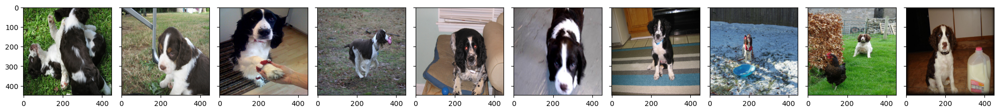

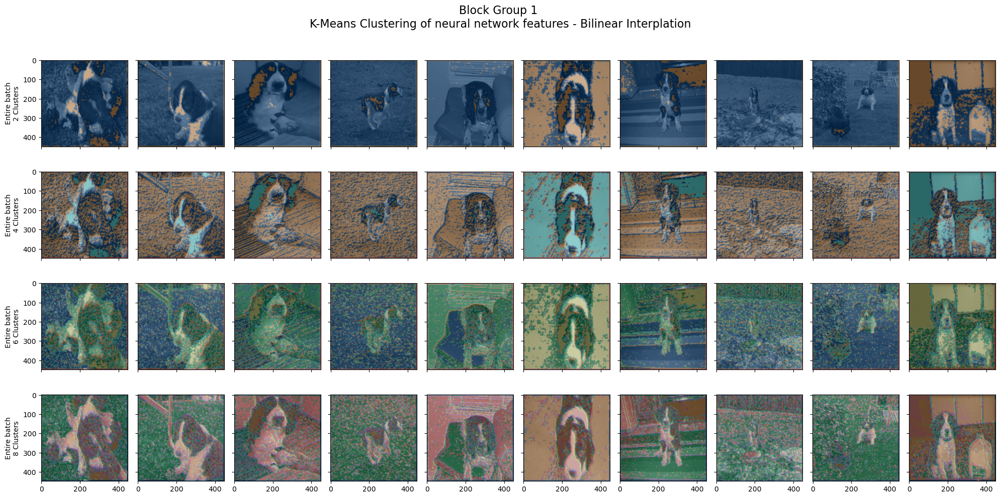

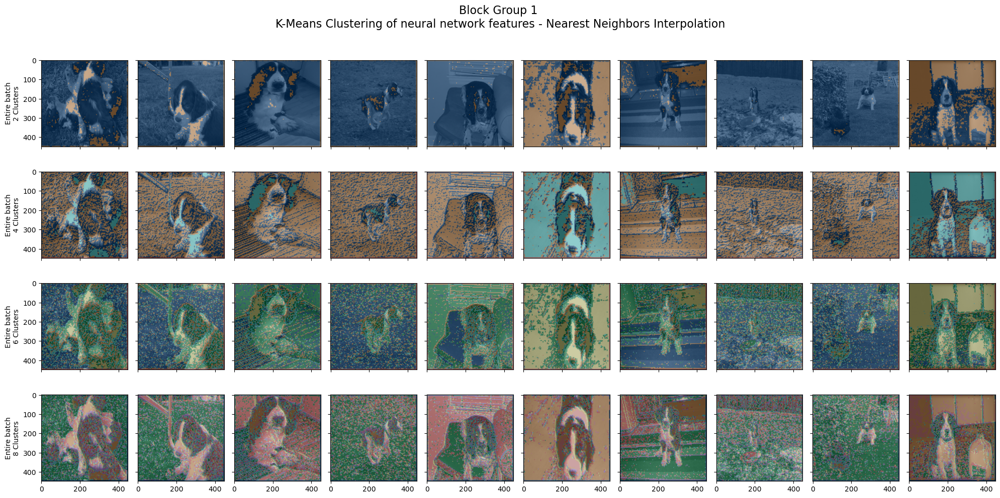

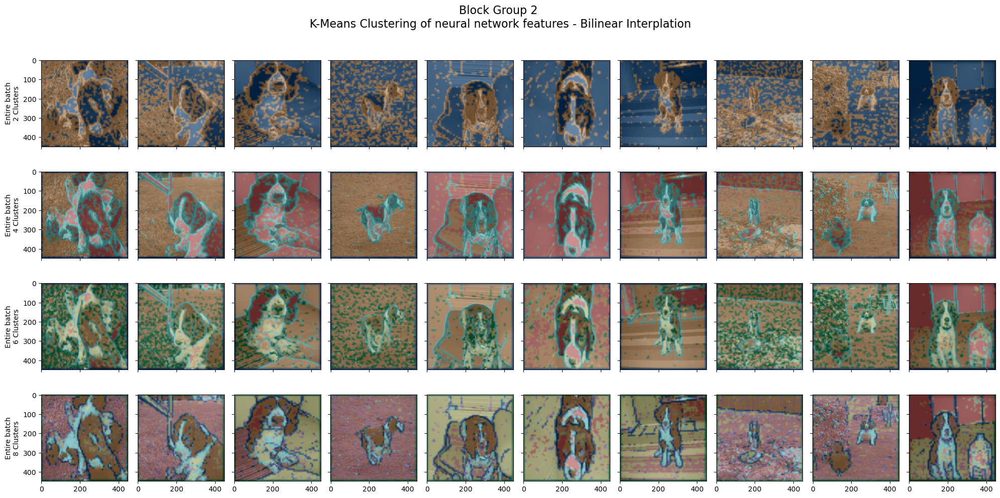

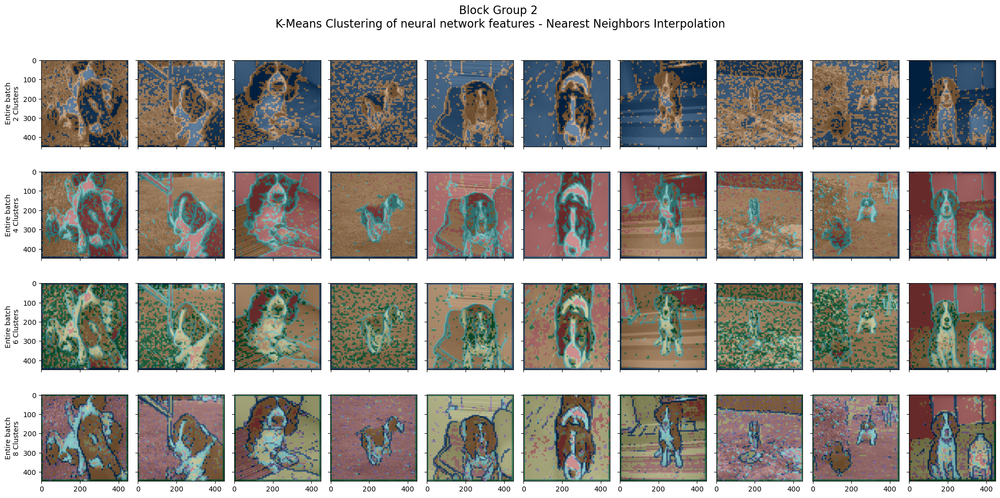

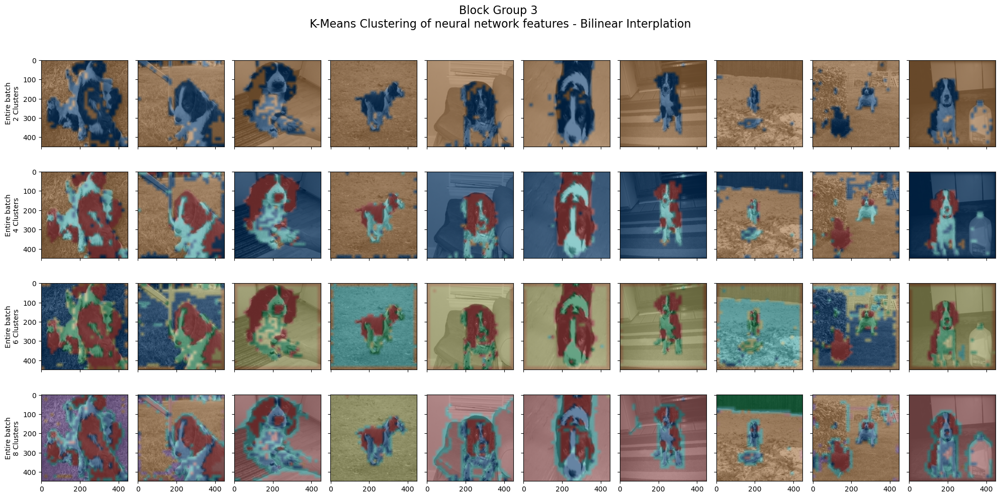

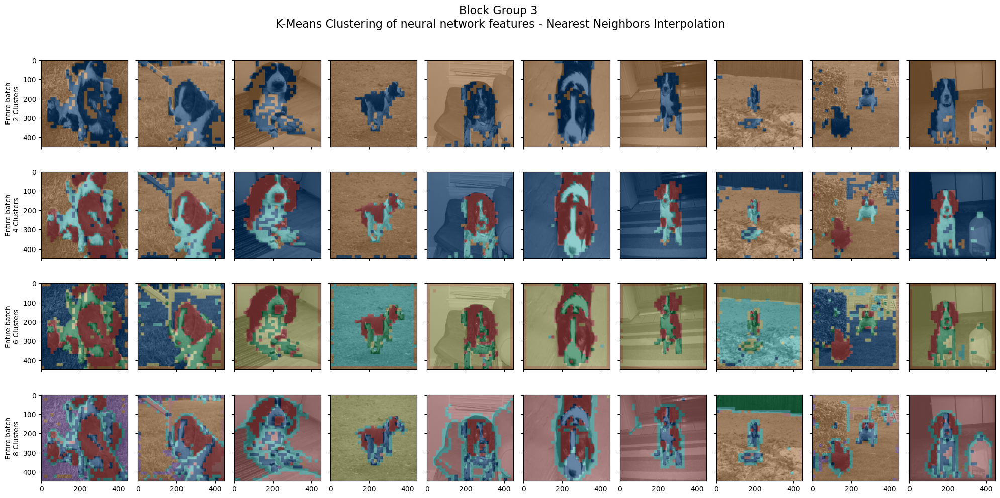

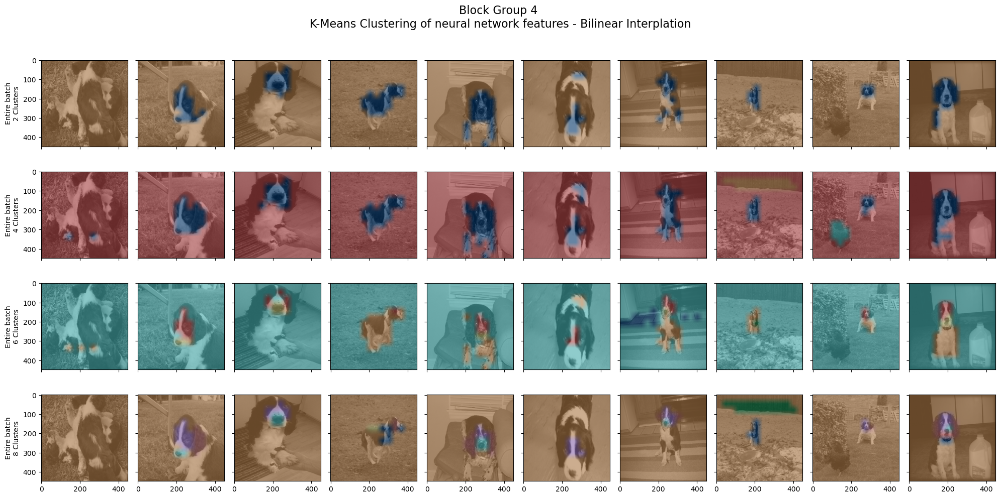

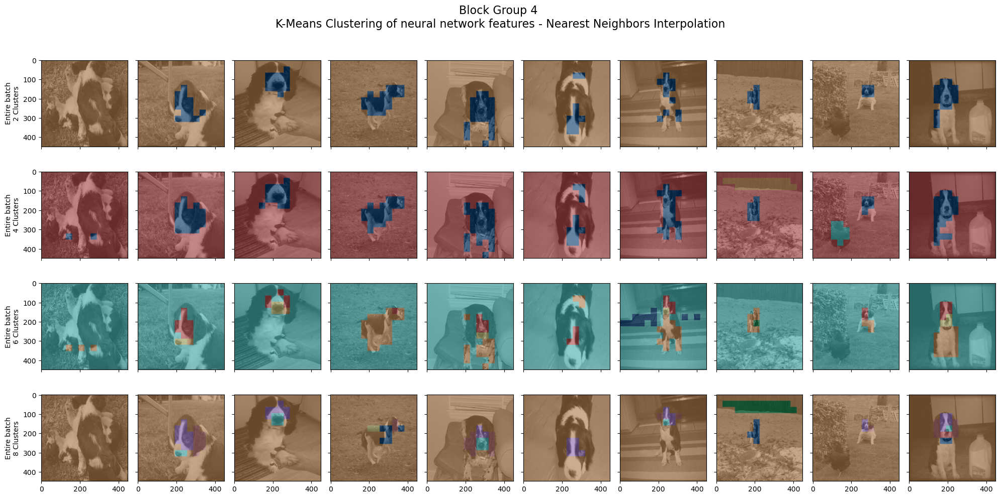

In [103]:
# Plots

# Raw images
fig, axs = plt.subplots(nrows=1, ncols=batch_size,
                        figsize=(20, 10), sharex=True, sharey=True)
axs = axs.flatten()
for img, ax in zip(batch_images, axs):
    ax.imshow(img)
fig.tight_layout()
plt.show()

for idx_block in range(len(blocks_batch_paths)):
    block_num = idx_block + 1
    # Bilinear Interplation
    fig, axs = plt.subplots(nrows=len(k_s), ncols=batch_size,
                            figsize=(20, 10), sharex=True, sharey=True)
    axs = axs.flatten()
    i = 0
    j = 0
    for img_kmeans, ax in zip(final_images_bilinear_interp[idx_block],
                              axs):
        if i % batch_size == 0:
            ax.set_ylabel(f"Entire batch\n"
                          + f"{k_s[j]} Clusters")
            j += 1
        ax.imshow(img_kmeans)
        i += 1
    fig.suptitle(
        f"Block Group {block_num} \n"
        + "K-Means Clustering of neural network features "
        + "- Bilinear Interplation",
        y=1.0, fontsize=16)
    fig.tight_layout()
    plt.show()

    # Nearest Neighbors Interpolation
    fig, axs = plt.subplots(nrows=len(k_s), ncols=batch_size,
                            figsize=(20, 10), sharex=True, sharey=True)
    axs = axs.flatten()
    i = 0
    j = 0
    for img_kmeans, ax in zip(final_images_nn_interp[idx_block], axs):
        if i % batch_size == 0:
            ax.set_ylabel(f"Entire batch\n"
                          + f"{k_s[j]} Clusters")
            j += 1
        ax.imshow(img_kmeans)
        i += 1
    fig.suptitle(
        f"Block Group {block_num} \n"
        + "K-Means Clustering of neural network features "
        + "- Nearest Neighbors Interpolation",
        y=1.0, fontsize=16)
    fig.tight_layout()
    plt.show()